### Human Action detection by keypoints using media pipe

In [73]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
import time
import mediapipe as mp
import tensorflow as tf
import os
import random
from collections import deque



from sklearn.model_selection import train_test_split

from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential,load_model
from tensorflow.keras.utils import to_categorical , plot_model
from tensorflow.keras.callbacks import EarlyStopping,ModelCheckpoint


Key points using MP

In [2]:
#holistic model
mp_holistic = mp.solutions.holistic
#for drawing
mp_drawing = mp.solutions.drawing_utils


In [3]:
mp_holistic.FACEMESH_TESSELATION

frozenset({(18, 17),
           (82, 38),
           (8, 9),
           (456, 248),
           (167, 2),
           (303, 271),
           (69, 104),
           (253, 450),
           (41, 42),
           (315, 16),
           (73, 74),
           (339, 373),
           (258, 385),
           (105, 63),
           (219, 48),
           (304, 272),
           (236, 217),
           (231, 22),
           (85, 84),
           (365, 367),
           (237, 218),
           (243, 112),
           (436, 427),
           (409, 410),
           (248, 456),
           (330, 266),
           (136, 135),
           (88, 95),
           (394, 430),
           (107, 108),
           (118, 117),
           (439, 438),
           (442, 443),
           (260, 466),
           (115, 48),
           (342, 276),
           (121, 128),
           (200, 421),
           (113, 124),
           (132, 137),
           (23, 230),
           (343, 357),
           (443, 444),
           (62, 78),
           (26,

In [3]:
def mediapipe_detection(image,model):
    image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
    image.flags.writeable = False
    results = model.process(image) #make prediction
    image.flags.writeable = True
    image = cv2.cvtColor(image,cv2.COLOR_RGB2BGR)
    return image,results

In [94]:
def draw_landmarks(image,results):
    mp_drawing.draw_landmarks(image,results.pose_landmarks,mp_holistic.POSE_CONNECTIONS)
    #mp_drawing.draw_landmarks(image,results.left_hand_landmarks,mp_holistic.HAND_CONNECTIONS)
    #mp_drawing.draw_landmarks(image,results.right_hand_landmarks,mp_holistic.HAND_CONNECTIONS)


In [7]:
mp_drawing.draw_landmarks??

Signature:
mp_drawing.draw_landmarks(
    image: numpy.ndarray,
    landmark_list: mediapipe.framework.formats.landmark_pb2.NormalizedLandmarkList,
    connections: Union[List[Tuple[int, int]], NoneType] = None,
    landmark_drawing_spec: Union[mediapipe.python.solutions.drawing_utils.DrawingSpec, Mapping[int, mediapipe.python.solutions.drawing_utils.DrawingSpec]] = DrawingSpec(color=(0, 0, 255), thickness=2, circle_radius=2),
    connection_drawing_spec: Union[mediapipe.python.solutions.drawing_utils.DrawingSpec, Mapping[Tuple[int, int], mediapipe.python.solutions.drawing_utils.DrawingSpec]] = DrawingSpec(color=(224, 224, 224), thickness=2, circle_radius=2),
)
Source:   
def draw_landmarks(
    image: np.ndarray,
    landmark_list: landmark_pb2.NormalizedLandmarkList,
    connections: Optional[List[Tuple[int, int]]] = None,
    landmark_drawing_spec: Union[DrawingSpec,
                                 Mapping[int, DrawingSpec]] = DrawingSpec(
                                     color

In [7]:
image = cv2.imread('z.jpg')


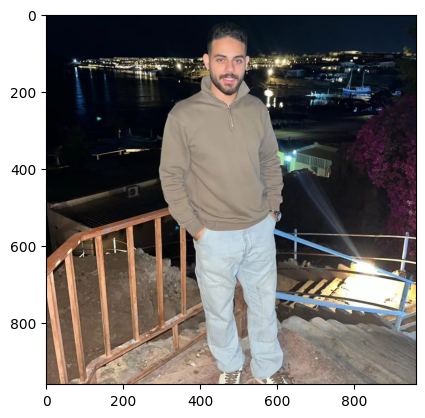

In [8]:
plt.imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))

In [9]:
with mp_holistic.Holistic(min_detection_confidence=0.5,min_tracking_confidence=0.5) as holistic:

    im , results = mediapipe_detection(image=image,model=holistic)

In [14]:
draw_landmarks(image,results)

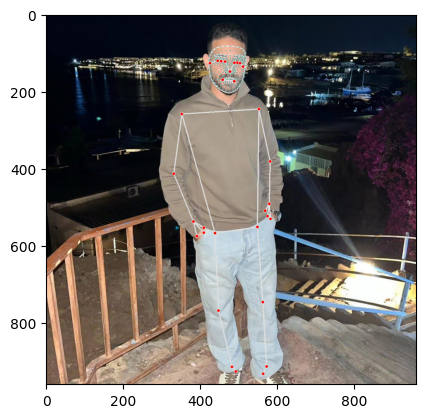

In [15]:
#all landmarks
plt.imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))

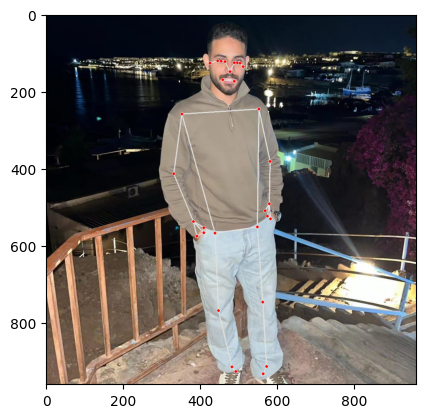

In [11]:
#only pose
plt.imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))

keypoints extraction

In [48]:
results.pose_landmarks.landmark[0].x

0.5892698764801025

In [49]:
len(results.face_landmarks.landmark)

468

In [79]:
np.array([[res.x,res.y,res.z,res.visibility] for res in results.pose_landmarks.landmark]).flatten()

array([ 6.02540910e-01,  2.66679853e-01, -6.18462741e-01,  9.99998331e-01,
        6.22554243e-01,  2.02023625e-01, -5.78928173e-01,  9.99997139e-01,
        6.34468913e-01,  2.04126224e-01, -5.78516424e-01,  9.99997020e-01,
        6.45688176e-01,  2.07495779e-01, -5.77983201e-01,  9.99996364e-01,
        5.81790149e-01,  2.00741574e-01, -5.81408203e-01,  9.99997377e-01,
        5.65965891e-01,  2.01395944e-01, -5.80830455e-01,  9.99996901e-01,
        5.52088082e-01,  2.02494785e-01, -5.80929577e-01,  9.99996543e-01,
        6.60424590e-01,  2.46720150e-01, -3.15304488e-01,  9.99996722e-01,
        5.27156949e-01,  2.34631807e-01, -3.26555461e-01,  9.99998510e-01,
        6.22702777e-01,  3.43610406e-01, -5.19232631e-01,  9.99996483e-01,
        5.72565377e-01,  3.36863846e-01, -5.23244262e-01,  9.99998093e-01,
        7.39158094e-01,  6.31109953e-01, -1.10412575e-01,  9.99695718e-01,
        4.14964110e-01,  5.46215713e-01, -1.81329921e-01,  9.99698520e-01,
        8.53401542e-01,  

In [ ]:
#flatten will give to us flatten np array we can use it in face verfication task using holistic.FACEMESH

In [5]:
#only we takes pose to make it Dense as much as possiable
def extract_keypoints(results):
    pose = np.array([[res.x, res.y, res.z, res.visibility] for res in results.pose_landmarks.landmark]).flatten() if results.pose_landmarks else np.zeros(33*4)
    return np.array(pose)


In [18]:
res = extract_keypoints(results)

In [20]:
res.shape

(132,)

Setup the experment

In [6]:
DATA_PATH = 'data/UCF50/UCF50/'
ACTIONS = np.array(['JumpingJack','PullUps','PushUps','JumpRope'])
SEQUENCE_LENGTH = 30 # 30 Frames


In [7]:
all_classes_names = os.listdir('data/UCF50/UCF50/')
print(f"number of classes : {len(all_classes_names)}")
all_classes_names

number of classes : 50


['BaseballPitch',
 'Basketball',
 'BenchPress',
 'Biking',
 'Billiards',
 'BreastStroke',
 'CleanAndJerk',
 'Diving',
 'Drumming',
 'Fencing',
 'GolfSwing',
 'HighJump',
 'HorseRace',
 'HorseRiding',
 'HulaHoop',
 'JavelinThrow',
 'JugglingBalls',
 'JumpingJack',
 'JumpRope',
 'Kayaking',
 'Lunges',
 'MilitaryParade',
 'Mixing',
 'Nunchucks',
 'PizzaTossing',
 'PlayingGuitar',
 'PlayingPiano',
 'PlayingTabla',
 'PlayingViolin',
 'PoleVault',
 'PommelHorse',
 'PullUps',
 'Punch',
 'PushUps',
 'RockClimbingIndoor',
 'RopeClimbing',
 'Rowing',
 'SalsaSpin',
 'SkateBoarding',
 'Skiing',
 'Skijet',
 'SoccerJuggling',
 'Swing',
 'TaiChi',
 'TennisSwing',
 'ThrowDiscus',
 'TrampolineJumping',
 'VolleyballSpiking',
 'WalkingWithDog',
 'YoYo']

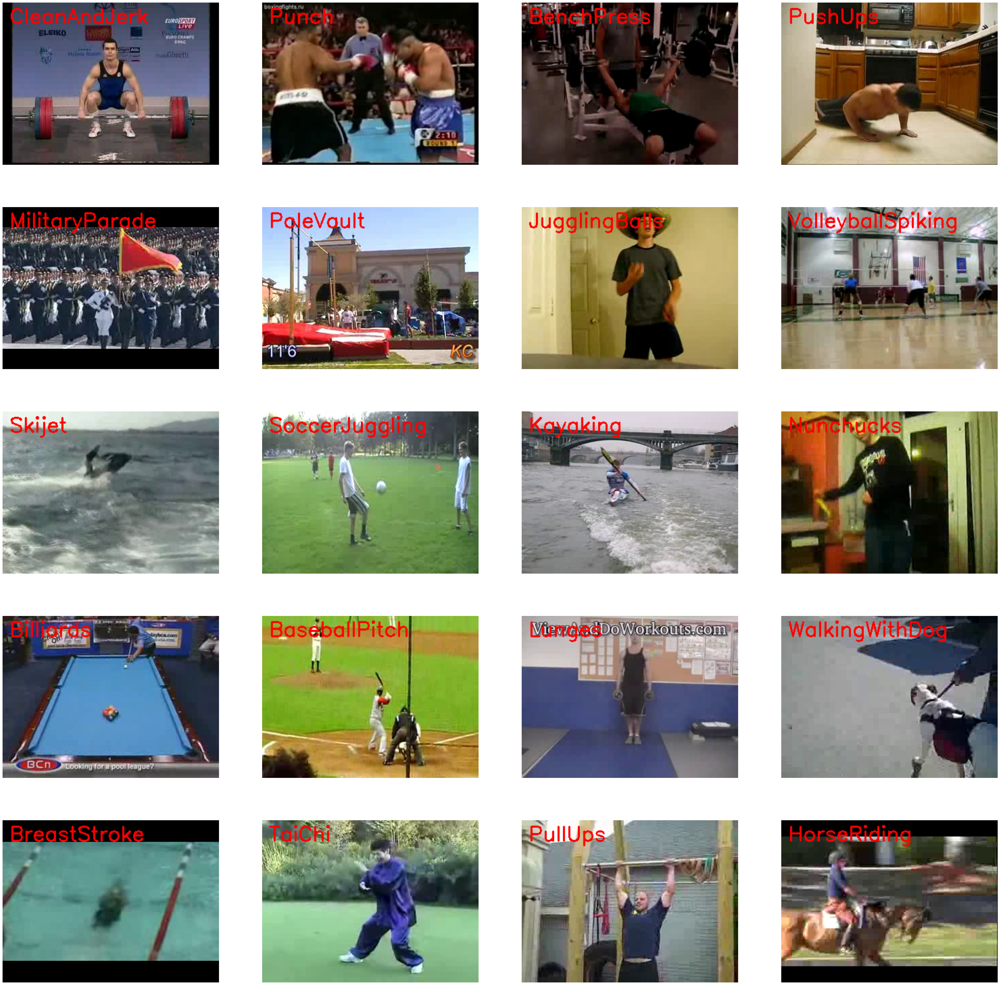

In [38]:
random_range = random.sample(range(len(all_classes_names)),20)
plt.figure(figsize=(50,50))

for counter,random_index in enumerate(random_range,1):
    selected_class_name = all_classes_names[random_index]
    video_names = os.listdir(os.path.join(DATA_PATH,selected_class_name))
    video_file = random.choice(video_names)
    video_reader = cv2.VideoCapture(os.path.join(DATA_PATH,selected_class_name,video_file))
    _,bgr_frame  = video_reader.read()
    
    video_reader.release()
    
    rgb_frame = cv2.cvtColor(bgr_frame,cv2.COLOR_BGR2RGB)
    cv2.putText(rgb_frame,selected_class_name,(10,30),cv2.FONT_HERSHEY_SIMPLEX,1,(255,0,0),2) 
    plt.subplot(5,4,counter)
    plt.imshow(rgb_frame)
    plt.axis('off')    
    
    
    
    

In [24]:
minimum_class = 100000000000000
for cls in ACTIONS:
    minimum_class = min(minimum_class,len(os.listdir(os.path.join(DATA_PATH,cls))))
    print(f'class name : {cls} | {len(os.listdir(os.path.join(DATA_PATH,cls)))}')

class name : JumpingJack | 123
class name : PullUps | 120
class name : PushUps | 106
class name : JumpRope | 148


In [26]:
minimum_class

106

In [8]:
def frames_extraction(video_path):
    keypoints_list = []
    video_reader = cv2.VideoCapture(video_path)
    video_frames_num = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))#property
    skip_frames_window = max(int(video_frames_num/SEQUENCE_LENGTH),1)
    with mp_holistic.Holistic(min_detection_confidence=0.5,min_tracking_confidence=0.5) as holistic:

        for frame_counter in range(SEQUENCE_LENGTH):
            video_reader.set(cv2.CAP_PROP_POS_FRAMES,frame_counter*skip_frames_window)
            
            ok,frame = video_reader.read()
            if not ok:
                break
            
            image , result = mediapipe_detection(image=frame,model=holistic)
            keypoints = extract_keypoints(result)
            
            
            keypoints_list.append(keypoints)
        
        video_reader.release()
        return keypoints_list
    

In [9]:
def Create_dataset(data_path,Classes_List):
    features = []
    labels = []
    video_paths = []
    for class_index,class_name in enumerate(Classes_List):
        print(f'Extracting Data of Class: {class_name}')
        files_list = os.listdir(os.path.join(data_path,class_name))
        for filename in files_list:
            video_path = os.path.join(data_path,class_name,filename)
            frames = frames_extraction(video_path=video_path)
            if len(frames) == SEQUENCE_LENGTH:
                features.append(frames)
                labels.append(class_index)
                video_paths.append(video_path)
    
    return features, labels, video_paths

In [16]:
features,labels,video_paths = Create_dataset(data_path=DATA_PATH,Classes_List=ACTIONS)

Extracting Data of Class: JumpingJack
Extracting Data of Class: PullUps
Extracting Data of Class: PushUps
Extracting Data of Class: JumpRope


In [17]:
import pickle

In [18]:
features

[[array([ 0.46349844,  0.26484475, -0.37653884,  0.99989617,  0.4696967 ,
          0.25383136, -0.35564798,  0.99979585,  0.47287783,  0.2544578 ,
         -0.35573101,  0.99978024,  0.47645283,  0.25524113, -0.35583553,
          0.99980134,  0.45696917,  0.25341535, -0.36002001,  0.99975818,
          0.45230407,  0.25379151, -0.36006019,  0.99973124,  0.44825068,
          0.25421277, -0.3600868 ,  0.99976391,  0.48164767,  0.2651408 ,
         -0.21454778,  0.99970227,  0.44359177,  0.26385179, -0.23404333,
          0.99970514,  0.47109336,  0.28158838, -0.32215843,  0.99992001,
          0.45589033,  0.28127307, -0.32784897,  0.99989748,  0.51592648,
          0.37010941, -0.10823594,  0.99958831,  0.41692677,  0.3702727 ,
         -0.12265803,  0.99956959,  0.51349604,  0.47336623, -0.02879332,
          0.73244137,  0.42289656,  0.48408973, -0.02087809,  0.52921343,
          0.50909579,  0.57955509, -0.10636999,  0.20395371,  0.42072183,
          0.57899445, -0.03673856,  0.

In [19]:
features = np.array(features) #no. of videos , seq_len,number of features

In [20]:
features.shape

(496, 30, 132)

In [2]:
import pickle

In [24]:
with open('features.pkl', 'wb') as file:
    pickle.dump(features, file)

In [3]:
with open('features.pkl', 'rb') as file:
    features = pickle.load(file)


In [4]:
features.shape

(496, 30, 132)

In [22]:
with open('labels.pkl', 'wb') as file:
    pickle.dump(labels, file)

In [23]:
with open('labels.pkl', 'rb') as file:
    labels = pickle.load(file)


In [26]:
one_hot = to_categorical(labels)

In [27]:
one_hot

array([[1., 0., 0., 0.],
       [1., 0., 0., 0.],
       [1., 0., 0., 0.],
       ...,
       [0., 0., 0., 1.],
       [0., 0., 0., 1.],
       [0., 0., 0., 1.]], dtype=float32)

In [28]:
#train test
features_train , features_test , labels_train , labels_test = train_test_split(
    features,
    one_hot,
    test_size=0.15,
    shuffle=True,
    random_state=27
)

In [29]:
print(f'train features shape : {features_train.shape} | labels train shape : {labels_train.shape}')

train features shape : (421, 30, 132) | labels train shape : (421, 4)


In [30]:
print(f'test features shape : {features_test.shape} | labels test shape : {labels_test.shape}')

test features shape : (75, 30, 132) | labels test shape : (75, 4)


In [31]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM,Dense
from tensorflow.keras.callbacks import TensorBoard

In [33]:
import keras_tuner

In [59]:
def create_LSTM_model(hp):
    model = Sequential()
    model.add(LSTM(64, return_sequences=True, activation=hp.Choice('activation', ['relu', 'tanh']),input_shape=(30,132)))
    model.add(LSTM(128, return_sequences=True, activation=hp.Choice('activation', ['relu', 'tanh'])))
    model.add(LSTM(64, return_sequences=False, activation=hp.Choice('activation', ['relu', 'tanh'])))
    model.add(Dense(hp.Choice('units', [16, 32, 64]),activation='relu'))
    model.add(Dense(hp.Choice('units', [8, 16, 32]),activation='relu'))
    model.add(Dense(ACTIONS.shape[0], activation='softmax'))
    learning_rate = hp.Float("lr", min_value=1e-4, max_value=1e-2, sampling="log")
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
        loss="categorical_crossentropy",
        metrics=["accuracy"]
    )
    model.summary()
    return model

In [63]:
tuner = keras_tuner.RandomSearch(
    create_LSTM_model,
    objective='val_loss',
    max_trials=5)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 30, 64)            50432     
                                                                 
 lstm_4 (LSTM)               (None, 30, 128)           98816     
                                                                 
 lstm_5 (LSTM)               (None, 64)                49408     
                                                                 
 dense_3 (Dense)             (None, 16)                1040      
                                                                 
 dense_4 (Dense)             (None, 16)                272       
                                                                 
 dense_5 (Dense)             (None, 4)                 68        
                                                                 
Total params: 200,036
Trainable params: 200,036
Non-tr

In [65]:
tuner.search(features_train, labels_train, epochs=20,validation_split=0.20,verbose=1)
best_model = tuner.get_best_models()[0]

Trial 5 Complete [00h 00m 08s]
val_loss: 0.4111974239349365

Best val_loss So Far: 0.11763159930706024
Total elapsed time: 00h 01m 03s
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 30, 64)            50432     
                                                                 
 lstm_1 (LSTM)               (None, 30, 128)           98816     
                                                                 
 lstm_2 (LSTM)               (None, 64)                49408     
                                                                 
 dense (Dense)               (None, 32)                2080      
                                                                 
 dense_1 (Dense)             (None, 32)                1056      
                                                                 
 dense_2 (Dense)             (None, 4)               

In [42]:
print(best_model.__doc__)

`Sequential` groups a linear stack of layers into a `tf.keras.Model`.

    `Sequential` provides training and inference features on this model.

    Examples:

    ```python
    # Optionally, the first layer can receive an `input_shape` argument:
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(8, input_shape=(16,)))
    # Afterwards, we do automatic shape inference:
    model.add(tf.keras.layers.Dense(4))

    # This is identical to the following:
    model = tf.keras.Sequential()
    model.add(tf.keras.Input(shape=(16,)))
    model.add(tf.keras.layers.Dense(8))

    # Note that you can also omit the `input_shape` argument.
    # In that case the model doesn't have any weights until the first call
    # to a training/evaluation method (since it isn't yet built):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(8))
    model.add(tf.keras.layers.Dense(4))
    # model.weights not created yet

    # Whereas if you specify the input shape, the mode

In [66]:
best_model.evaluate(features_test,labels_test)

3/3 [==============================] - 1s 37ms/step - loss: 0.0885 - accuracy: 0.9733


[0.08851680159568787, 0.9733333587646484]

In [79]:
tuner.search_space_summary()

Search space summary
Default search space size: 3
units (Choice)
{'default': 16, 'conditions': [], 'values': [16, 32, 64], 'ordered': True}
activation (Choice)
{'default': 'relu', 'conditions': [], 'values': ['relu', 'tanh'], 'ordered': False}
lr (Float)
{'default': 0.0001, 'conditions': [], 'min_value': 0.0001, 'max_value': 0.01, 'step': None, 'sampling': 'log'}


In [74]:
best_model.save('bestModel.h5')

In [99]:
def predict_on_video(video_file_path, output_file_path, SEQUENCE_LENGTH,model):
    # Initialize the VideoCapture object to read from the video file.
    video_reader = cv2.VideoCapture(video_file_path)

    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Initialize the VideoWriter Object to store the output video in the disk.
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('M', 'P', '4', 'V'), 
                                   video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))

    # Declare a queue to store video frames.
    frames_queue = deque(maxlen = SEQUENCE_LENGTH)

    # Initialize a variable to store the predicted action being performed in the video.
    predicted_class_name = ''
    with mp_holistic.Holistic(min_detection_confidence=0.5,min_tracking_confidence=0.5) as holistic:

        # Iterate until the video is accessed successfully.
        while video_reader.isOpened():

            # Read the frame.
            ok, frame = video_reader.read() 
            
            # Check if frame is not read properly then break the loop.
            if not ok:
                break            

            # Appending the pre-processed frame into the frames list.
            _ , result = mediapipe_detection(image=frame,model=holistic)
            keypoints = extract_keypoints(result)
            draw_landmarks(frame,result)
            frames_queue.append(keypoints)

            # Check if the number of frames in the queue are equal to the fixed sequence length.
            if len(frames_queue) == SEQUENCE_LENGTH:

                # Pass the normalized frames to the model and get the predicted probabilities.
                predicted_labels_probabilities = model.predict(np.expand_dims(frames_queue, axis = 0))[0]

                # Get the index of class with highest probability.
                thresh = 0.7
                prop = predicted_labels_probabilities[np.argmax(predicted_labels_probabilities)]
                if prop >=thresh:
                    predicted_label = np.argmax(predicted_labels_probabilities)
                    # Get the class name using the retrieved index.
                    predicted_class_name = ACTIONS[predicted_label]
                else:
                    predicted_class_name = 'No Action'

            # Write predicted class name on top of the frame.
            cv2.putText(frame, 'Result:', (0, 115), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
            cv2.putText(frame, predicted_class_name, (int(original_video_width/4), 115), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)

            # Write The frame into the disk using the VideoWriter Object.
            video_writer.write(frame)
            
    # Release the VideoCapture and VideoWriter objects.
    video_reader.release()
    video_writer.release()

In [98]:
n = 2
for i in range(8):
    predict_on_video(f'test{i}.mp4',f'result{i}-LSTM_{SEQUENCE_LENGTH}_mediapipe.mp4',30,best_model)

1/1 [==============================] - 0s 18ms/step


In [103]:
i=7
predict_on_video(f'test{i}.mp4',f'result{i}-LSTM_{SEQUENCE_LENGTH}_mediapipe.mp4',30,best_model)

1/1 [==============================] - 0s 20ms/step
